# SciPy John Hunter Excellence in Plotting Contest Submission

# Magnetotelluric Visualisation

Author: Thibaut Astic

thast@eos.ubc.ca

December 2015

In [10]:
#Import functions from .py file (included)
from MT_1D_analytic_nlayer_Earth import *

## building the model

In [2]:
#Number of layers in Earth model
nlayer = 2

#log10 of the frequency range
fmin= -5.
fmax = 5.

#Define the sampling frequencies
frangn = frange(fmin,fmax,100.)

#Define times to plot in the animation: setup to be one period.
frange1=2.*frange(4.,5.,1.)
t=np.arange(0.,1./(frange1.min()),0.01/(frange1.max()))
z=np.arange(-5000.,5000.,10.)

#Define the physical properties of Air and a 2-layered Earth

#Air and Earth layers thickness
thickkm = np.array([120000.,2000.])

#Eletrical conductivity: main contributor the signal
sigkm=np.array([0.,10.**(-5.),10.**(-4)])

#Relative dielectric permittivity
eps2=np.array([1.,1.,1.])

#Relative magnetic permittivity
mu2=np.array([1.,1.,1.])

#Cole-Cole chargeability parameters (amplitude, characteristic time decay, geometry) (none here)
chg2_0=np.array([0.,0.,0.])
taux2=np.array([0.,0.1,0.])
c2=np.array([1.,1.,1.])

## Calculate the fields and data in time and space

In [3]:
#Calculate the E and H fields, Up and down components, (+ auxiliary variables UDaux and layer) both in time and space
Exzt,Hyzt,Uz,Dz,UDaux,layer = calculateEHzt(frange1,thickkm,sigkm,chg2_0,taux2,c2,mu2,eps2,2,z,t)

#Simulate the MT data
Reskm,Phasekm = appres(frangn,thickkm,sigkm,chg2_0,taux2,c2,mu2,eps2,2)

## Turn it into a movie!

In [8]:
#Define the subplots and group associated fields
#ax0: Electric Field ; ax1:Up component ; ax2:Apparent resistivity ; ax3:Magnetic field ; ax4:Down component; ax5 Phase
fig = plt.figure(figsize=(12,12))
ax0 = plt.subplot2grid((20,20), (0, 10),colspan=8,rowspan=8)
ax1 = plt.subplot2grid((20,20), (10, 10),colspan=8,rowspan=8)
ax2 = plt.subplot2grid((20,20), (1, 0), colspan=8,rowspan=16)

#Link the axes scales
ax3=ax0.twiny()
ax4= ax1.twiny()
ax5=ax2.twiny()

#Plot Data
ax2.scatter(Reskm,frangn,color='black')
ax5.scatter(Phasekm,frangn,color='purple')

#Set scale and legends for the data plot
widthn=np.logspace(np.log10(Reskm.min())-1., np.log10(Reskm.max())+1., num=100, endpoint=True, base=10.0)
frange1n=np.ones(100)*frange1
ax2.plot(widthn,frange1n,linestyle='dashed',color='black')
ax2.set_xscale('Log')
ax2.set_yscale('Log')
ax2.set_ylim([frangn.min(),frangn.max()])
ax2.set_xlim([10.**(np.log10(Reskm.min())-1.),10.**(np.log10(Reskm.max())+1.)])
ax2.set_xlabel('Apparent Resistivity (Ohm*m)',fontsize=20,color='black')
ax2.set_ylabel('Frequency (Hz)',fontsize=16)
ax2.grid(which='major')
ax2.annotate(("%10.0f Hz")%(frange1),
            xy=(5*Reskm.max(),frange1), xycoords='data',
            xytext=(5*Reskm.max(),frange1), textcoords='data',
            fontsize=16., fontweight='bold')
ax5.set_xlim([0.,90.])
ax5.set_xlabel('Phase (Degrees)',fontsize=20,color='purple')

#Initialize the fields plotting
#Define updatable plots and theirs colors
line0, =ax0.plot([],[],color='blue')
line1, =ax3.plot([],[],color='red')
line2, =ax1.plot([],[],color='green')
line3, =ax4.plot([],[],color='brown')

#Fill to show the maximum amplitude in time at different z
ax0.fill_betweenx(z,np.squeeze(np.asarray(np.real(Exzt.min(axis=1)))),
                      np.squeeze(np.asarray(np.real(Exzt.max(axis=1)))), 
                      color='blue', alpha=0.1)

ax3.fill_betweenx(z,np.squeeze(np.asarray(np.real(Hyzt.min(axis=1)))),
                      np.squeeze(np.asarray(np.real(Hyzt.max(axis=1)))), 
                      color='red', alpha=0.1)

ax1.fill_betweenx(z,np.squeeze(np.asarray(np.real(Uz.min(axis=1)))),
                      np.squeeze(np.asarray(np.real(Uz.max(axis=1)))), 
                      color='green', alpha=0.1,where=(z>0.))

ax4.fill_betweenx(z,np.squeeze(np.asarray(np.real(Dz.min(axis=1)))),
                     np.squeeze(np.asarray(np.real(Dz.max(axis=1)))), 
                     color='brown', alpha=0.1,where=(z>0.))
    
#Set limits for x-axis
ax0.set_xlim([np.real(Exzt).min(),np.real(Exzt).max()])
ax3.set_xlim([np.real(Hyzt).min(),np.real(Hyzt).max()])
ax1.set_xlim([np.real(Dz).min(),np.real(Dz).max()])
ax4.set_xlim([np.real(Dz).min(),np.real(Dz).max()])

#Plot the layered Earth and the physical properties
PlotConfiguration(thickkm,sigkm,eps2,mu2,ax0,np.abs(Exzt.max()),z)
PlotConfiguration(thickkm,sigkm,eps2,mu2,ax1,np.abs(Dz.max()),z)


#change ticks size and numbers
ax0.tick_params(labelsize=12)
ax1.tick_params(labelsize=12)
ax2.tick_params(labelsize=16)
ax3.tick_params(labelsize=12)
ax3.locator_params(axis='x',nbins=7)
ax4.tick_params(labelsize=12)
ax5.tick_params(labelsize=16)

#Set labels
ax0.set_xlabel('Electric Field E (V/m)',color='blue',fontsize=16)
ax0.set_ylabel('Depth (m)',fontsize=16)
ax1.set_xlabel('Up component of E (V/m)',color='green',fontsize=16)
ax1.set_ylabel('Depth (m)',fontsize=16)
ax3.set_xlabel('Magnetic Field H (A/m)',color='red',fontsize=16)
ax4.set_xlabel('Down component of E (V/m)',color='brown',fontsize=16)

plt.tight_layout()

#funtion to make a animated plot with the fields
def visualiseE(ts):
        
    line0.set_data(np.real(Exzt[:,ts]),z)
    line1.set_data(np.real(Hyzt[:,ts]),z)
    line2.set_data(np.real(Uz[:,ts]),z)
    line3.set_data(np.real(Dz[:,ts]),z)
    ax0.set_title(("time =  %10.0f $\mu s$")%(t[ts]*10**6), x=0., y=-0.25,fontsize=16.,fontweight="bold")
    
#Making the movie
movieMT_time=animation.FuncAnimation(fig, visualiseE, frames=len(t))

#To only display the first frame
#visualiseE(0)

#Save the movie
#movieMT_time.save('[your path]/movieMT.html', writer=HTMLWriter(embed_frames=True))


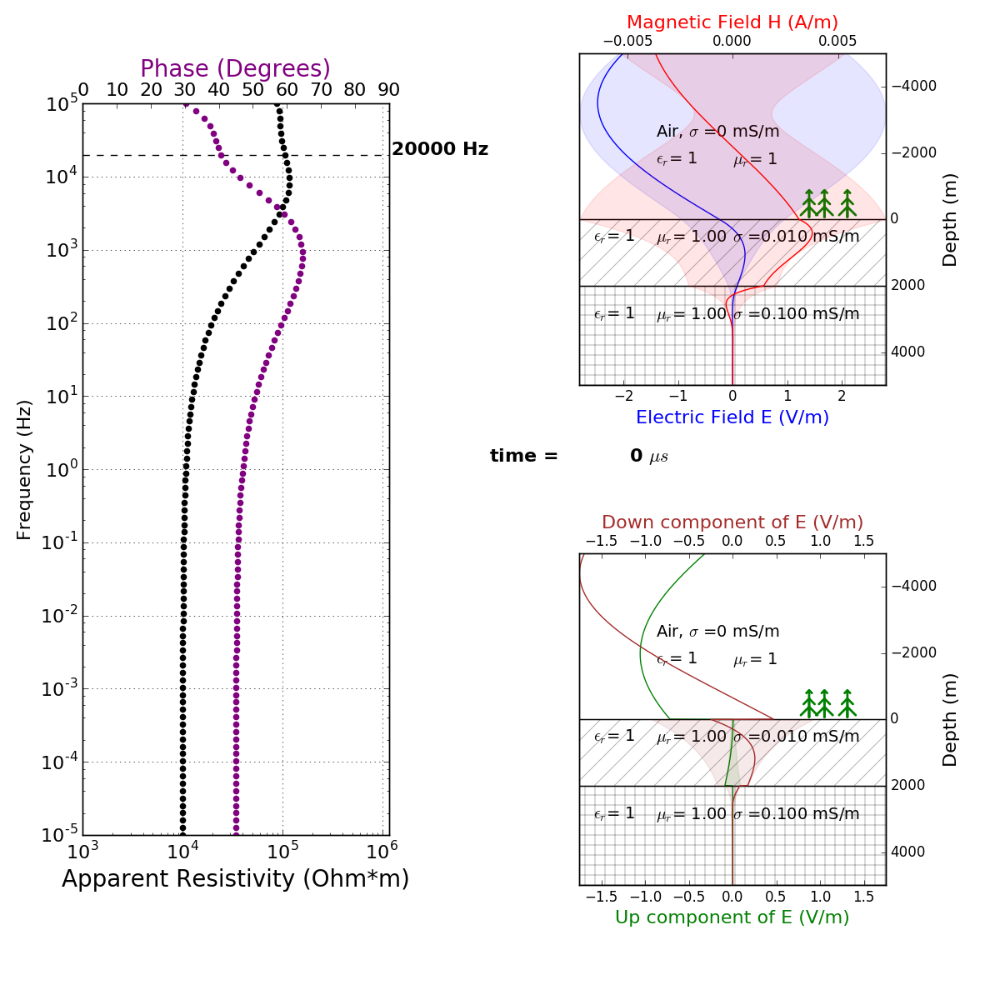
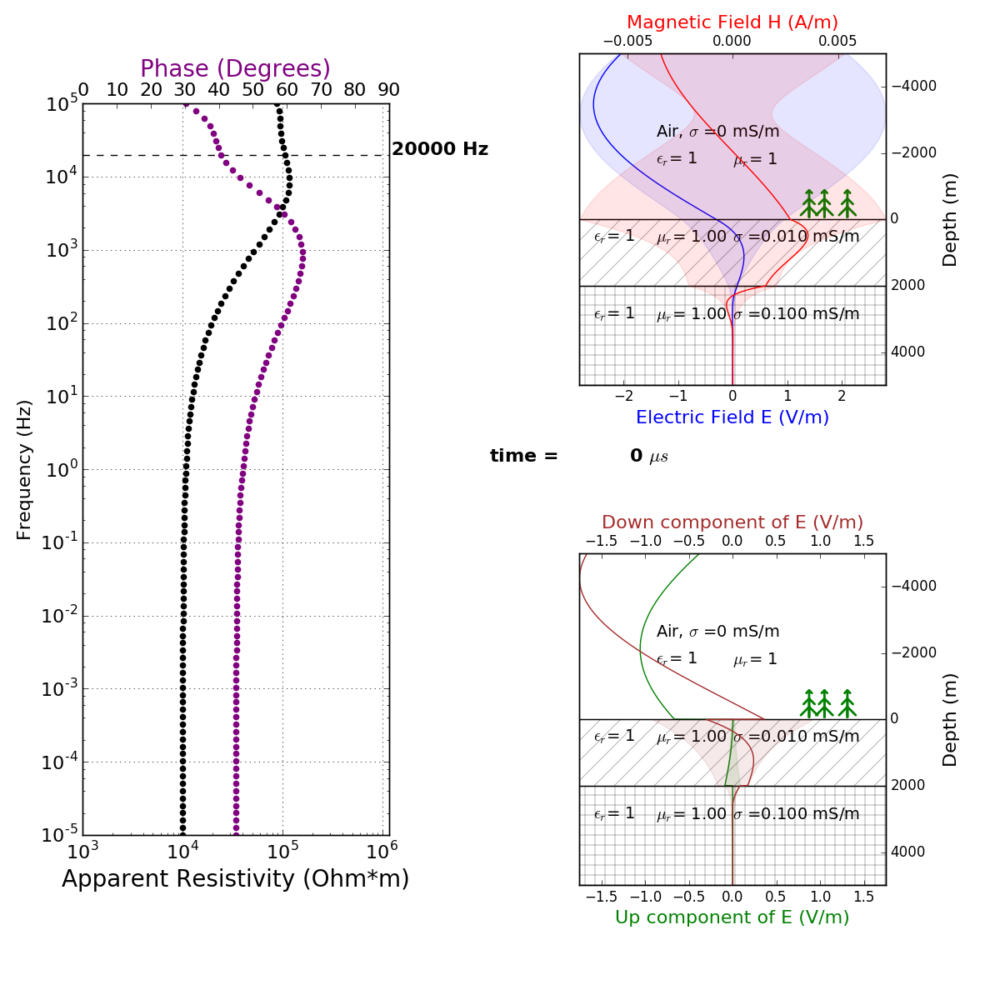
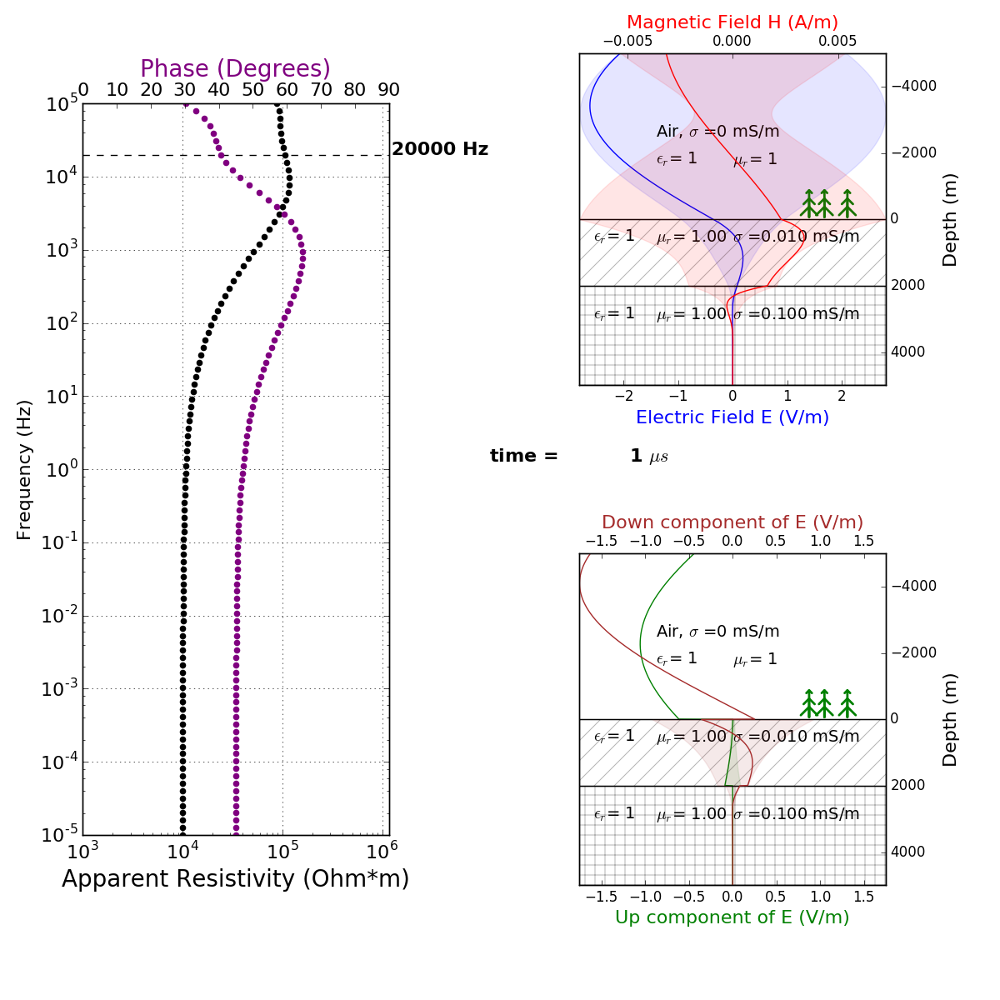
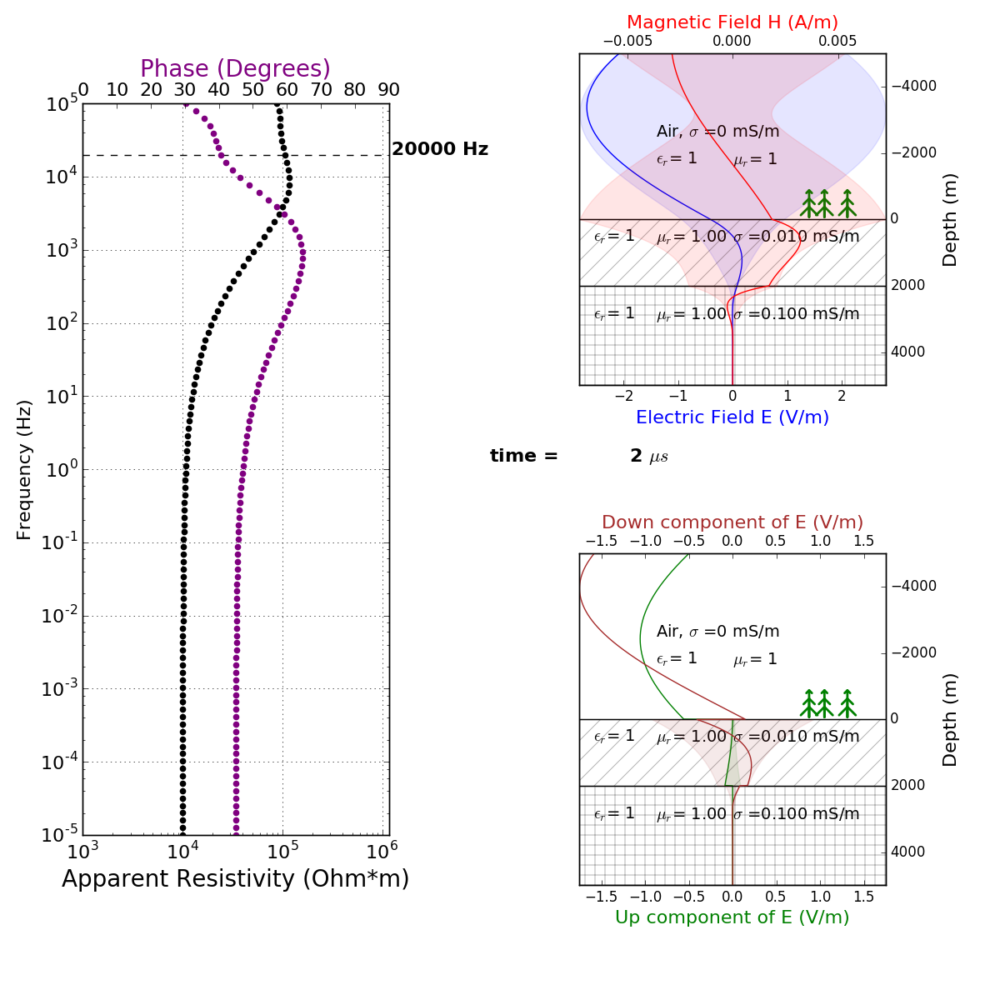
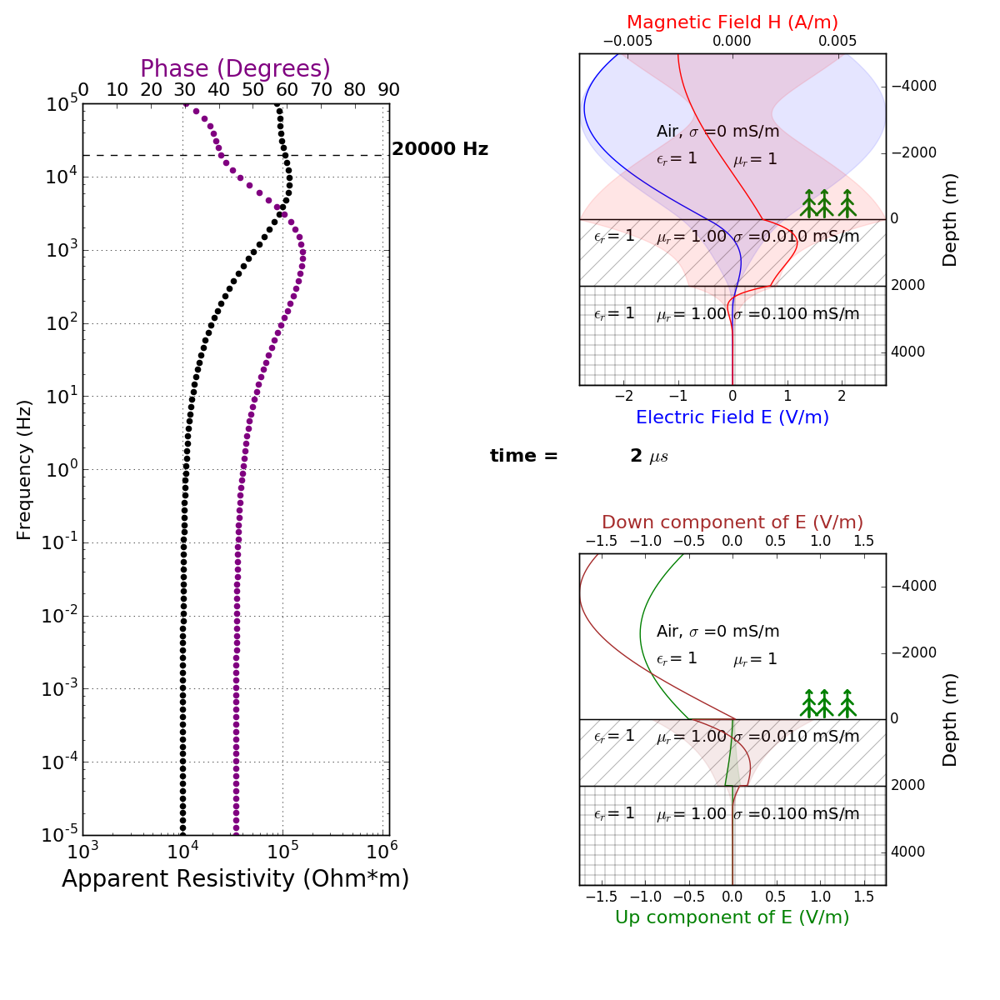
...
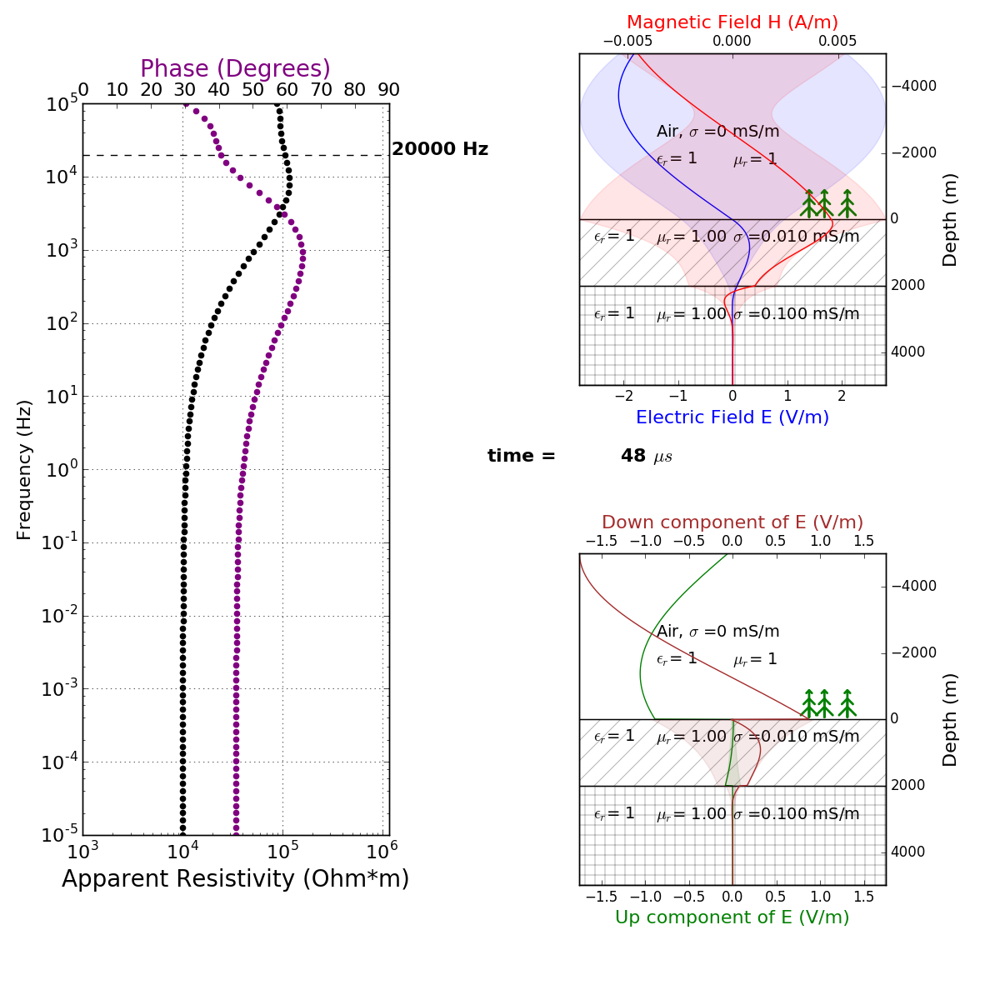
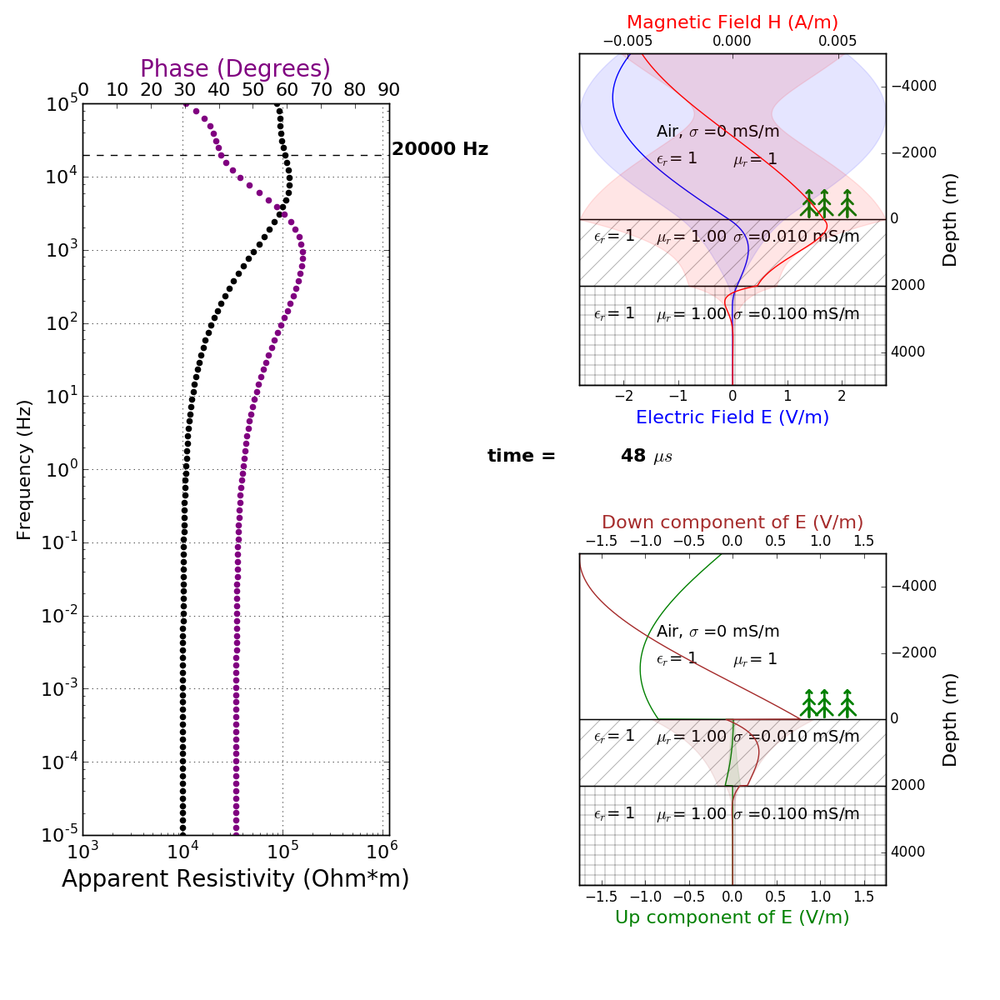
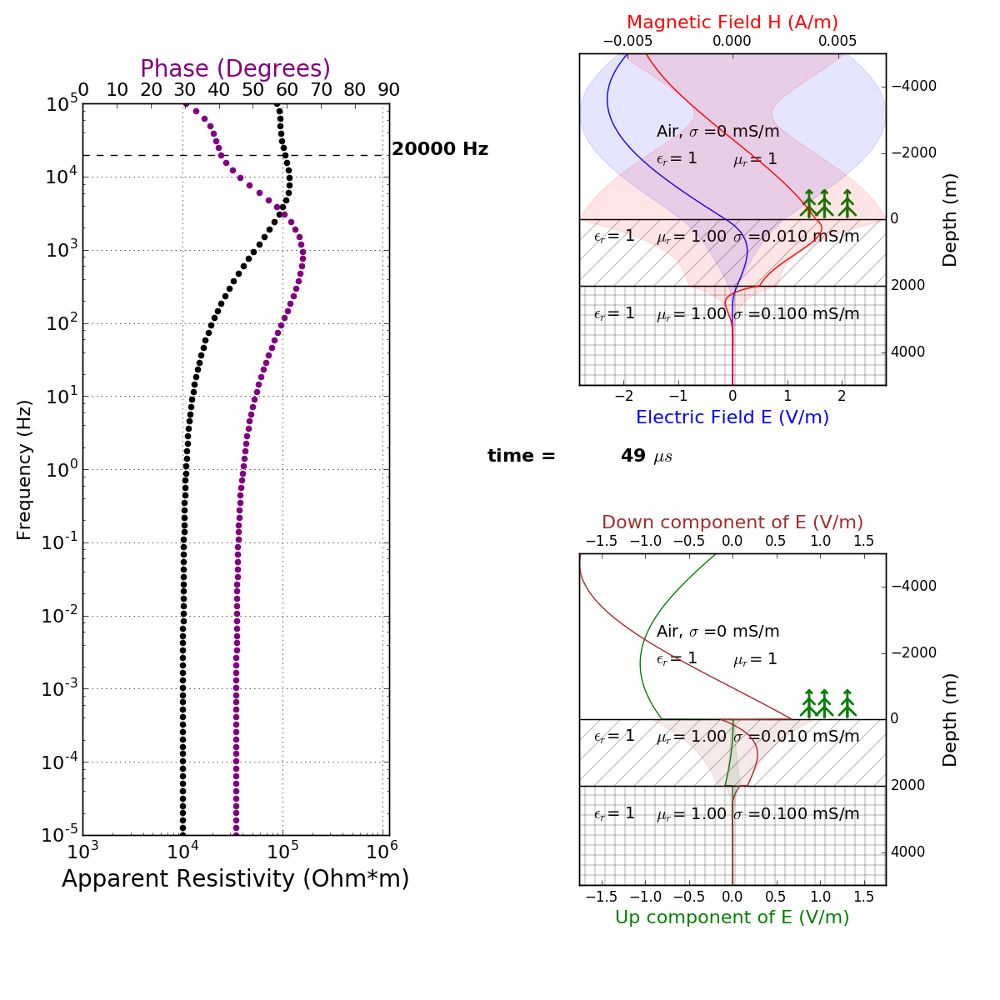
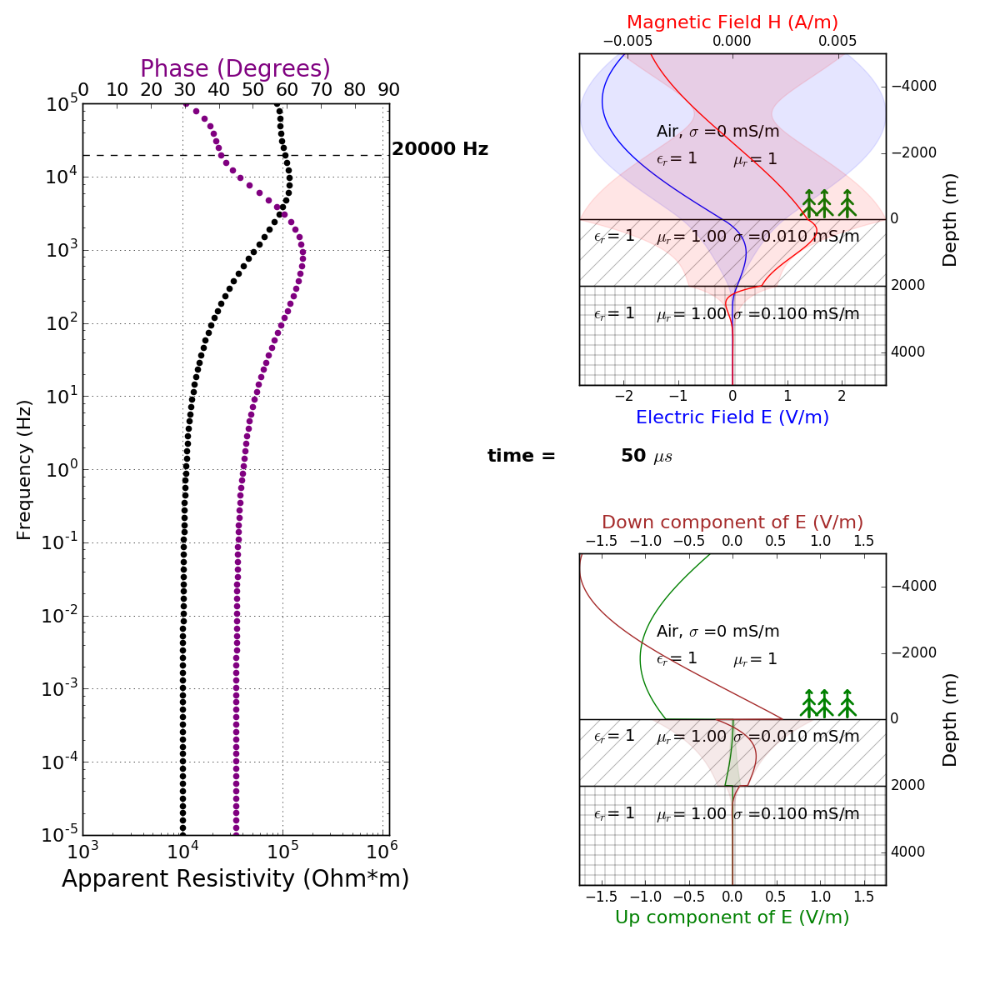
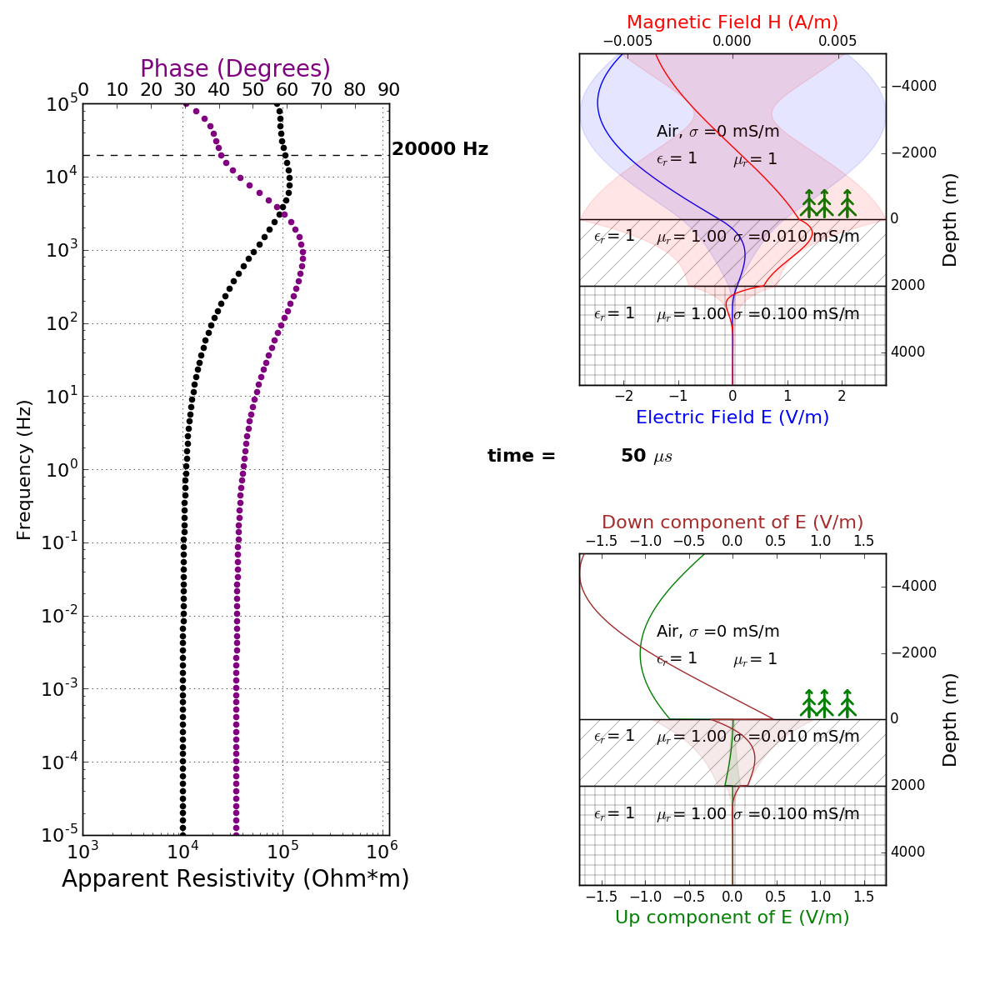

In [9]:
#Look at the movie
movieMT_time